<a href="https://colab.research.google.com/github/Mike030668/MIPT_magistratura/blob/main/ModNet%20/Image_Bind/Image_Bind_manipulations_advanced.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installation ImageBind.git

https://github.com/softmurata/colab_notebooks/blob/main/multimodality/imagebind.ipynb

https://colab.research.google.com/drive/1D3hlz-742A8aNSREpKZXHLE6PvTpyfVJ?hl=ja#scrollTo=xZJxeJXTGXSg

In [ ]:
!git clone https://github.com/facebookresearch/ImageBind.git
!pip install git+https://github.com/facebookresearch/pytorchvideo.git@28fe037d212663c6a24f373b94cc5d478c8c1a1d timm==0.6.7 ftfy regex einops fvcore decord==0.6.0

Cloning into 'ImageBind'...
remote: Enumerating objects: 112, done.
remote: Counting objects: 100% (61/61), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 112 (delta 43), reused 33 (delta 33), pack-reused 51
Receiving objects: 100% (112/112), 2.64 MiB | 24.55 MiB/s, done.
Resolving deltas: 100% (50/50), done.
  Cloning https://github.com/facebookresearch/pytorchvideo.git (to revision 28fe037d212663c6a24f373b94cc5d478c8c1a1d) to /tmp/pip-req-build-51ju0k7m
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/pytorchvideo.git /tmp/pip-req-build-51ju0k7m
  Running command git rev-parse -q --verify 'sha^28fe037d212663c6a24f373b94cc5d478c8c1a1d'
  Running command git fetch -q https://github.com/facebookresearch/pytorchvideo.git 28fe037d212663c6a24f373b94cc5d478c8c1a1d
  Running command git checkout -q 28fe037d212663c6a24f373b94cc5d478c8c1a1d
  Resolved https://github.com/facebookresearch/pytorchvideo.git to commit 28fe037d212663c6a

# Data Checker

In [ ]:
%cd /content/ImageBind

/content/ImageBind


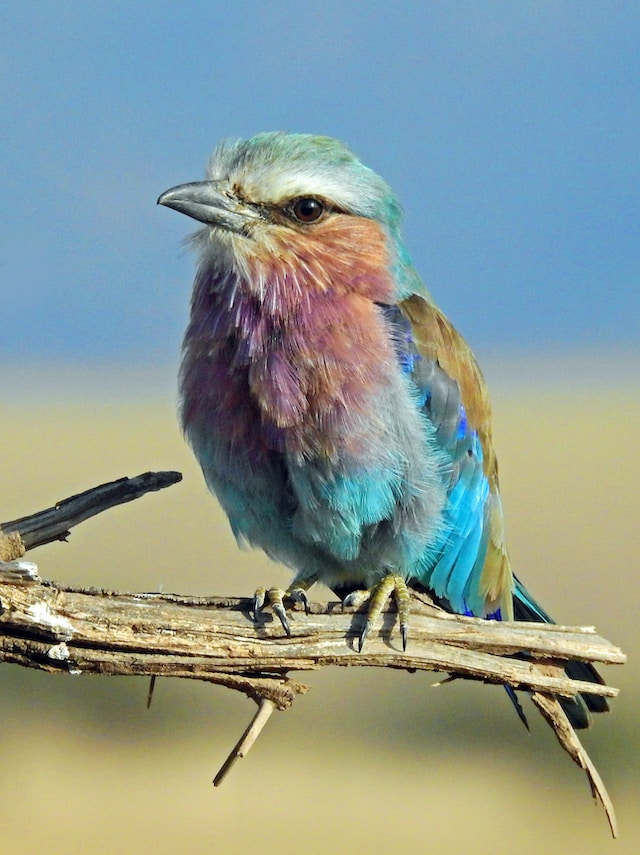

In [ ]:
import IPython
from PIL import Image

text = 'bird'
display(Image.open(f".assets/{text}_image.jpg"))
IPython.display.Audio(f".assets/{text}_audio.wav")

# Modify model

In [ ]:
import sys
sys.path.append('/content/ImageBind')
import ImageBind

In [ ]:
import os
from imagebind.models.imagebind_model import ImageBindModel
import torch

class ImageBindModel_up(ImageBindModel):
      # добаляем в forward возможность включить и выключить normalize
      def forward(self, inputs, normalize=True):
          outputs = {}
          for modality_key, modality_value in inputs.items():
              reduce_list = (
                  modality_value.ndim >= 5
              )  # Audio and Video inputs consist of multiple clips
              if reduce_list:
                  B, S = modality_value.shape[:2]
                  modality_value = modality_value.reshape(
                      B * S, *modality_value.shape[2:]
                  )

              if modality_value is not None:
                  modality_value = self.modality_preprocessors[modality_key](
                      **{modality_key: modality_value}
                  )
                  trunk_inputs = modality_value["trunk"]
                  head_inputs = modality_value["head"]
                  modality_value = self.modality_trunks[modality_key](**trunk_inputs)
                  modality_value = self.modality_heads[modality_key](
                      modality_value, **head_inputs
                  )
                  if normalize:
                      modality_value = self.modality_postprocessors[modality_key](
                          modality_value
                      )

                  if reduce_list:
                      modality_value = modality_value.reshape(B, S, -1)
                      modality_value = modality_value.mean(dim=1)

                  outputs[modality_key] = modality_value

          return outputs


# будем вносить веса не методом изнутри класса, а снаружи функцией
def get_weights(model):
    if not os.path.exists(".checkpoints/imagebind_huge.pth"):
        print(
            "Downloading imagebind weights to .checkpoints/imagebind_huge.pth ..."
        )
        os.makedirs(".checkpoints", exist_ok=True)
        torch.hub.download_url_to_file(
            "https://dl.fbaipublicfiles.com/imagebind/imagebind_huge.pth",
            ".checkpoints/imagebind_huge.pth",
            progress=True,
        )

    model.load_state_dict(torch.load(".checkpoints/imagebind_huge.pth"))

    return model



/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional_tensor.py:5: UserWarning: The torchvision.transforms.functional_tensor module is deprecated in 0.15 and will be **removed in 0.17**. Please don't rely on it. You probably just need to use APIs in torchvision.transforms.functional or in torchvision.transforms.v2.functional.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/transforms/_functional_video.py:6: UserWarning: The 'torchvision.transforms._functional_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms.functional' module instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/transforms/_transforms_video.py:22: UserWarning: The 'torchvision.transforms._transforms_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms' module instead.
  warnings.warn(


## Instantiate model

In [26]:
# Instantiate model
model = ImageBindModel_up(
              vision_embed_dim=1280,
              vision_num_blocks=32,
              vision_num_heads=16,
              text_embed_dim=1024,
              text_num_blocks=24,
              text_num_heads=16,
              out_embed_dim=1024,
              audio_drop_path=0.1,
              imu_drop_path=0.7
              )

device = "cuda:0" if torch.cuda.is_available() else "cpu"

model = get_weights(model).eval().to(device)

# Классифиация по косинусному сходтву модальностей

In [ ]:
import imagebind.data as data
from imagebind.models.imagebind_model import ModalityType

text_list=["A bird", "A car", "A dog."]
image_paths=[".assets/dog_image.jpg", ".assets/car_image.jpg", ".assets/bird_image.jpg"]
audio_paths=[".assets/dog_audio.wav", ".assets/car_audio.wav", ".assets/bird_audio.wav"]

# Load data
inputs = {
    ModalityType.TEXT: data.load_and_transform_text(text_list, device),
    ModalityType.VISION: data.load_and_transform_vision_data(image_paths, device),
    ModalityType.AUDIO: data.load_and_transform_audio_data(audio_paths, device),
}

with torch.no_grad():
    embeddings = model(inputs)


print()

print(
    "Vision x Text:\n ",
    torch.softmax(embeddings[ModalityType.VISION] @ embeddings[ModalityType.TEXT].T, dim=-1),
    '\n'
)
print(
    "Audio x Text:\n ",
    torch.softmax(embeddings[ModalityType.AUDIO] @ embeddings[ModalityType.TEXT].T, dim=-1),
    '\n'
)
print(
    "Vision x Audio:\n ",
    torch.softmax(embeddings[ModalityType.VISION] @ embeddings[ModalityType.AUDIO].T, dim=-1),
    '\n'
)



Vision x Text:
  tensor([[1.8612e-05, 2.3694e-03, 9.9761e-01],
        [2.4118e-05, 9.9994e-01, 3.3837e-05],
        [9.8646e-01, 1.3496e-02, 4.7997e-05]], device='cuda:0') 

Audio x Text:
  tensor([[0., 0., 1.],
        [0., 1., 0.],
        [1., 0., 0.]], device='cuda:0') 

Vision x Audio:
  tensor([[0.8070, 0.1088, 0.0842],
        [0.1036, 0.7884, 0.1079],
        [0.0018, 0.0022, 0.9960]], device='cuda:0') 



Тут видна классификация выходов имбедингов моделей соответствующих модальностей по косинусному сходству.

И результаты очень высокие

# Добавление модальности глубины изображения
на основе модели Depth

In [ ]:
!pip install transformers -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 52.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 33.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 93.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 83.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 34.0 MB/s eta 0:00:00


# depth estimator

In [10]:
# depth estimator
# https://huggingface.co/spaces/nielsr/dpt-depth-estimation/blob/main/app.py
from transformers import DPTFeatureExtractor, DPTForDepthEstimation
import torch
import numpy as np
import PIL
import matplotlib.pyplot as plt
%matplotlib inline

In [11]:
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-large")
model_dpt = DPTForDepthEstimation.from_pretrained("Intel/dpt-large")

/usr/local/lib/python3.10/dist-packages/transformers/models/dpt/feature_extraction_dpt.py:28: FutureWarning: The class DPTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use DPTImageProcessor instead.
  warnings.warn(


Some weights of DPTForDepthEstimation were not initialized from the model checkpoint at Intel/dpt-large and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.convolution2.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


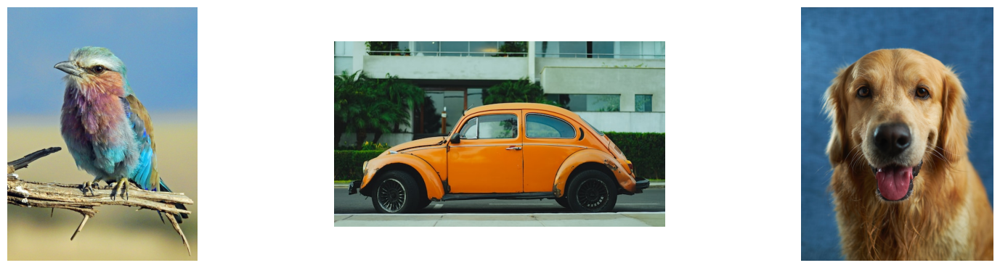

In [12]:
pil_images = []
texts = ("bird", "car", "dog")

for text in texts:
  pil_img = PIL.Image.open(f"/content/ImageBind/.assets/{text}_image.jpg")
  pil_images.append(pil_img)

plt.figure(figsize=(20,10))
columns = 3
for i, image in enumerate(pil_images):
    plt.subplot(int(len(pil_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.axis(False)

## feature_extractor

In [13]:
encoding = feature_extractor(pil_images, return_tensors="pt")
encoding['pixel_values'].shape

torch.Size([3, 3, 384, 384])

In [14]:
encoding

{'pixel_values': tensor([[[[-0.0902, -0.0824, -0.0588,  ..., -0.1216, -0.1294, -0.1294],
          [-0.0980, -0.0902, -0.0902,  ..., -0.1216, -0.1294, -0.1216],
          [-0.1059, -0.0902, -0.0902,  ..., -0.1137, -0.0980, -0.0902],
          ...,
          [ 0.6471,  0.6471,  0.6471,  ...,  0.4980,  0.4980,  0.5137],
          [ 0.6314,  0.6314,  0.6392,  ...,  0.5059,  0.5137,  0.5216],
          [ 0.6235,  0.6314,  0.6314,  ...,  0.5137,  0.5294,  0.5216]],

         [[ 0.2706,  0.2784,  0.2863,  ...,  0.2706,  0.2784,  0.2784],
          [ 0.2863,  0.2941,  0.2863,  ...,  0.2706,  0.2627,  0.2627],
          [ 0.3098,  0.3098,  0.3020,  ...,  0.2784,  0.2706,  0.2706],
          ...,
          [ 0.5137,  0.5137,  0.5137,  ...,  0.4118,  0.4039,  0.4118],
          [ 0.5059,  0.4980,  0.5059,  ...,  0.4196,  0.4196,  0.4118],
          [ 0.5137,  0.5137,  0.4980,  ...,  0.4275,  0.4196,  0.4118]],

         [[ 0.5529,  0.5529,  0.5529,  ...,  0.5686,  0.5765,  0.5922],
          [ 0

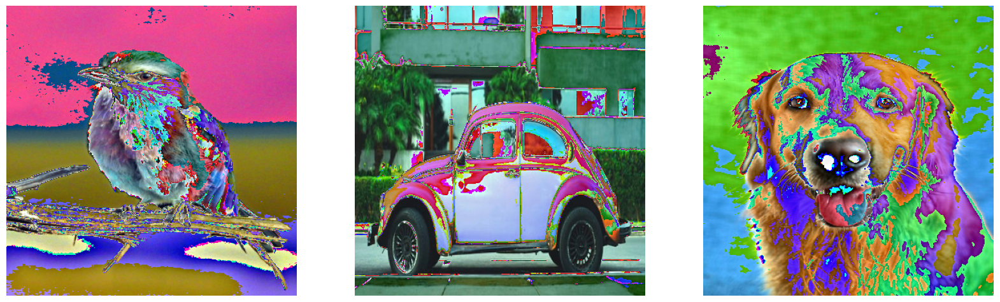

In [15]:
plt.figure(figsize=(20,10))
columns = 3
for i, image in enumerate(encoding['pixel_values']):
    plt.subplot(int(len(encoding) / columns + 1), columns, i + 1)
    output = image.permute((1,2,0)).numpy()
    formatted = (output * 255 / np.max(output)).astype('uint8')
    plt.imshow(formatted)
    plt.axis(False)

# predicted_depth

In [16]:
# forward pass
with torch.no_grad():
  outputs = model_dpt(**encoding)
  predicted_depth = outputs.predicted_depth

outputs

DepthEstimatorOutput(loss=None, predicted_depth=tensor([[[ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
         ...,
         [ 2.4694,  2.4936,  2.5509,  ...,  6.5318,  6.6106,  6.7245],
         [ 2.7084,  2.5873,  2.5974,  ...,  6.5541,  6.6683,  6.7764],
         [ 2.9785,  2.6659,  2.7152,  ...,  7.1571,  7.5714,  8.1808]],

        [[ 5.4926,  5.4702,  5.4601,  ...,  2.6797,  2.6993,  2.6633],
         [ 5.4795,  5.4530,  5.4554,  ...,  2.6734,  2.6800,  2.6462],
         [ 5.4643,  5.4690,  5.4560,  ...,  2.6739,  2.6864,  2.6401],
         ...,
         [28.8224, 28.9397, 28.8803,  ..., 27.2782, 27.2432, 27.2048],
         [29.1171, 29.1072, 29.1180,  ..., 27.4487, 27.3960, 27.3426],
         [29.2608, 29.2756, 29.2405,  ..., 27.5416, 27.5206, 27.3783]],

        [[ 0.1601,  0.1486,  0.1421,  ...,  0.7291,  0.7396,  0.8399

In [17]:
predicted_depth.shape

torch.Size([3, 384, 384])

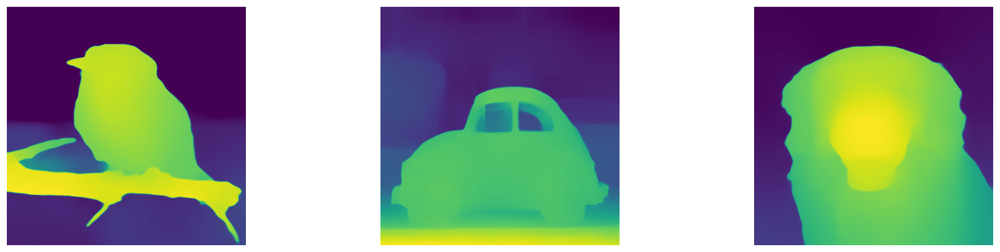

In [18]:
plt.figure(figsize=(20,10))
columns = 3
for i, (output, text) in enumerate(zip(predicted_depth, texts)):
    plt.subplot(int(len(predicted_depth) / columns + 1), columns, i + 1)
    output = output.cpu().numpy()
    formatted = (output * 255 / np.max(output)).astype('uint8')
    plt.imshow(formatted) #, cmap = 'gray')
    plt.axis(False)
    pred_img = Image.fromarray(formatted)
    pred_img.save(f"/content/ImageBind/.assets/{text}_depth.jpg")

# Cross modality

In [19]:
from torchvision import transforms
from PIL import Image
def load_and_transform_depth_data(depth_paths, device):
    if depth_paths is None:
        return None

    depth_ouputs = []
    for depth_path in depth_paths:
        data_transform = transforms.Compose(
            [
                transforms.Resize(
                    224, interpolation=transforms.InterpolationMode.BICUBIC
                ),
                transforms.CenterCrop(224),
                transforms.ToTensor(),
                transforms.Normalize((0.5, ), (0.5, ))
            ]
        )
        with open(depth_path, "rb") as fopen:
            image = Image.open(fopen).convert("L")

        image = data_transform(image).to(device)
        depth_ouputs.append(image)
    return torch.stack(depth_ouputs, dim=0)

In [20]:
text_list=["A dog.", "A car", "A bird"]

image_paths=[".assets/dog_image.jpg", ".assets/car_image.jpg", ".assets/bird_image.jpg"]
audio_paths=[".assets/dog_audio.wav", ".assets/car_audio.wav", ".assets/bird_audio.wav"]
depth_paths = [".assets/dog_depth.jpg", ".assets/car_depth.jpg", ".assets/bird_depth.jpg"]


# Load data
inputs = {
    ModalityType.TEXT: data.load_and_transform_text(text_list, device),
    ModalityType.VISION: data.load_and_transform_vision_data(image_paths, device),
    ModalityType.AUDIO: data.load_and_transform_audio_data(audio_paths, device),
    ModalityType.DEPTH: load_and_transform_depth_data(depth_paths, device),
}


with torch.no_grad():
    embeddings = model(inputs, normalize = False)


print()

print(
    "Vision x DEPTH:\n ",
    torch.softmax(embeddings[ModalityType.VISION] @ embeddings[ModalityType.DEPTH].T, dim=-1),
    '\n'
)
print(
    "Audio x DEPTH:\n ",
    torch.softmax(embeddings[ModalityType.AUDIO] @ embeddings[ModalityType.DEPTH].T, dim=-1),
    '\n'
)
print(
    "Text x DEPTH:\n ",
    torch.softmax(embeddings[ModalityType.TEXT] @ embeddings[ModalityType.DEPTH].T, dim=-1),
    '\n'
)


Vision x DEPTH:
  tensor([[1.0000e+00, 5.8438e-16, 4.1248e-16],
        [2.3577e-14, 2.9736e-19, 1.0000e+00],
        [1.0000e+00, 2.4268e-10, 4.4988e-07]], device='cuda:0') 

Audio x DEPTH:
  tensor([[1.0000e+00, 7.5824e-39, 4.6175e-38],
        [4.2231e-25, 1.4481e-39, 1.0000e+00],
        [1.0000e+00, 2.1325e-41, 7.8560e-08]], device='cuda:0') 

Text x DEPTH:
  tensor([[1.7710e-02, 3.7258e-06, 9.8229e-01],
        [2.4205e-02, 4.5513e-06, 9.7579e-01],
        [3.5600e-01, 8.7612e-04, 6.4313e-01]], device='cuda:0') 



Модель тоже не такх хорошо класифицирует, но раница внутри классов заметнее!

In [21]:
embeddings

{'text': tensor([[-0.1327, -0.4946, -0.1321,  ...,  0.2829, -0.6555, -0.2451],
         [-0.0550, -0.1147, -0.5434,  ...,  0.4576, -0.4531, -0.1470],
         [-0.1639, -0.1913, -0.0898,  ...,  0.3753, -0.3187,  0.0611]],
        device='cuda:0'),
 'vision': tensor([[ 0.0437, -0.6182,  0.1134,  ...,  0.2957,  0.0527,  0.3203],
         [ 0.5645,  0.1171,  0.8694,  ..., -0.5504, -0.1042, -0.4274],
         [ 0.4215,  0.1318,  1.2343,  ...,  0.0962,  0.2169, -0.2088]],
        device='cuda:0'),
 'audio': tensor([[-0.0527, -0.9323,  1.9049,  ...,  0.6345, -0.2531, -1.1615],
         [ 1.0737,  0.3055, -1.5566,  ...,  0.7463, -0.3519,  0.7189],
         [ 0.3802, -0.4204,  0.6558,  ..., -0.4062,  0.1388,  0.2337]],
        device='cuda:0'),
 'depth': tensor([[ 7.4487e-01,  1.0106e+00, -2.7862e-01,  ..., -5.8002e-01,
           3.1343e-01,  2.8579e-04],
         [ 3.4940e-01,  1.6067e-01,  7.5544e-01,  ..., -2.1015e-01,
           1.1058e-01, -9.5480e-01],
         [ 1.4490e+00, -8.2761e-02

# Интеграция ImageBind и StableUnCLIPImg2ImgPipeline
для генерации на основе имбедингов

https://huggingface.co/docs/diffusers/api/pipelines/stable_unclip

In [22]:
!pip install diffusers -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 18.0 MB/s eta 0:00:00


In [23]:
# лучше освободить место в памяти от модели глубины
del(model_dpt)

In [24]:
import gc
import torch
gc.collect()
torch.cuda.empty_cache()
torch.cuda.memory_summary(device=None, abbreviated=False)

'|===========================================================================|\n|                  PyTorch CUDA memory summary, device ID 0                 |\n|---------------------------------------------------------------------------|\n|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |\n|===========================================================================|\n|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |\n|---------------------------------------------------------------------------|\n| Allocated memory      |   4663 MiB |   4738 MiB |  16635 MiB |  11972 MiB |\n|       from large pool |   4639 MiB |   4714 MiB |  15439 MiB |  10799 MiB |\n|       from small pool |     23 MiB |     31 MiB |   1196 MiB |   1172 MiB |\n|---------------------------------------------------------------------------|\n| Active memory         |   4663 MiB |   4738 MiB |  16635 MiB |  11972 MiB |\n|       from large pool |   4639 MiB |   4714 MiB |

## Audio to Image

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

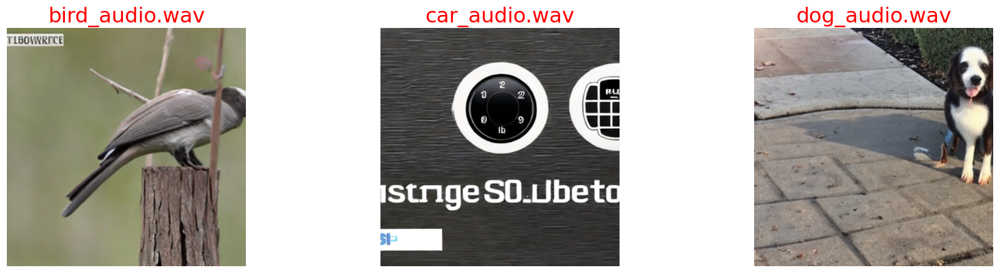

In [27]:
#import Pipeline
from diffusers import StableUnCLIPImg2ImgPipeline

pipe = StableUnCLIPImg2ImgPipeline.from_pretrained(
    "stabilityai/stable-diffusion-2-1-unclip",
    torch_dtype=torch.float16
)
pipe = pipe.to(device)


# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    audio_paths=[".assets/bird_audio.wav" , ".assets/car_audio.wav", ".assets/dog_audio.wav"]

    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data(audio_paths, device),
    })
    embeddings = embeddings[ModalityType.AUDIO]

    gen_images = []
    for emb in embeddings:
        img = pipe(image_embeds=emb[None].half(),
                   generator = generator
        ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, path) in enumerate(zip(gen_images, audio_paths)):
    name = path.split('/')[-1]
    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(name, fontdict={'fontsize': 22, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

## Audio + Prompt to Image

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

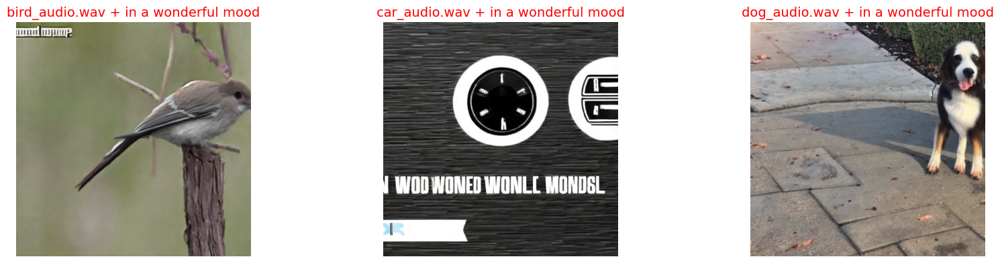

In [28]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    audio_paths=[".assets/bird_audio.wav" , ".assets/car_audio.wav", ".assets/dog_audio.wav"]

    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data(audio_paths, device),
    })

    audio_embeddings = embeddings[ModalityType.AUDIO]

    gen_images = []
    prompt='in a wonderful mood'

    for emb in audio_embeddings:
        img = pipe(
            prompt=prompt,
            image_embeds=emb[None].half(),
            generator = generator
            ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, path) in enumerate(zip(gen_images, audio_paths)):
    name = path.split('/')[-1]
    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(f'{name} + {prompt}', fontdict={'fontsize': 14, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

Интересно, что на каждой картинке есть малые изменения и не только в тексте на картинке, но и например в листья или мусоре около сабаки....

Сразу связь и не поймешь, но интересно!

## Убираем нормализацию

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

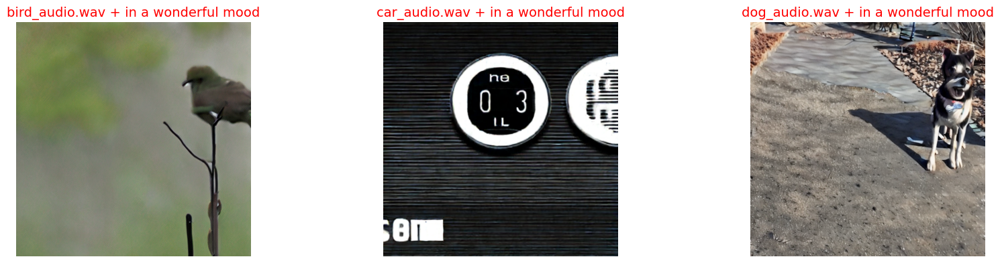

In [29]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    audio_paths=[".assets/bird_audio.wav" , ".assets/car_audio.wav", ".assets/dog_audio.wav"]

    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data(audio_paths, device),
    },  normalize = False)

    audio_embeddings = embeddings[ModalityType.AUDIO]

    gen_images = []
    prompt='in a wonderful mood'

    for emb in audio_embeddings:
        img = pipe(
            prompt=prompt,
            image_embeds=emb[None].half(),
            generator = generator
            ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, path) in enumerate(zip(gen_images, audio_paths)):
    name = path.split('/')[-1]
    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(f'{name} + {prompt}', fontdict={'fontsize': 14, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

Тексты или пропали или стали мешьше, но есть изкажения в картинках.

## Audio+Image to Image
https://huggingface.co/facebook/musicgen-large


audio_datasets_colab - https://colab.research.google.com/github/sanchit-gandhi/notebooks/blob/main/audio_datasets_colab.ipynb#scrollTo=958H4DCDhKbT

intro-to-DSP-with-python - https://github.com/earthspecies/intro-to-DSP-with-python


### Take audio dataset

In [30]:
!pip install --quiet git+https://github.com/huggingface/transformers.git datasets[audio]

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 493.7/493.7 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 18.4 MB/s eta 0:00:00


In [31]:
from datasets import load_dataset

dataset = load_dataset("sanchit-gandhi/gtzan", split="train", streaming=True)
dataset.info

DatasetInfo(description='', citation='', homepage='', license='', features={'file': Value(dtype='string', id=None), 'audio': Audio(sampling_rate=32000, mono=True, decode=True, id=None), 'genre': ClassLabel(names=['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock'], id=None)}, post_processed=None, supervised_keys=None, task_templates=None, builder_name='parquet', dataset_name='gtzan', config_name='default', version=0.0.0, splits={'train': SplitInfo(name='train', num_bytes=1322941192.0, num_examples=999, shard_lengths=None, dataset_name=None)}, download_checksums=None, download_size=1305519226, post_processing_size=None, dataset_size=1322941192.0, size_in_bytes=None)

In [32]:
import IPython.display as ipd

sample = next(iter(dataset))
audio = sample["audio"]
ipd.Audio(data=audio["array"], autoplay=True, rate=audio["sampling_rate"])

In [59]:
import scipy.io.wavfile as wavf
fs = audio["sampling_rate"]
music_name = sample['file'].split('/')[-1]
out_f = '/content/ImageBind/.assets/'+ music_name
res=audio["array"]
wavf.write(out_f, fs, res)

### Убирем нормализацию только в картинках

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

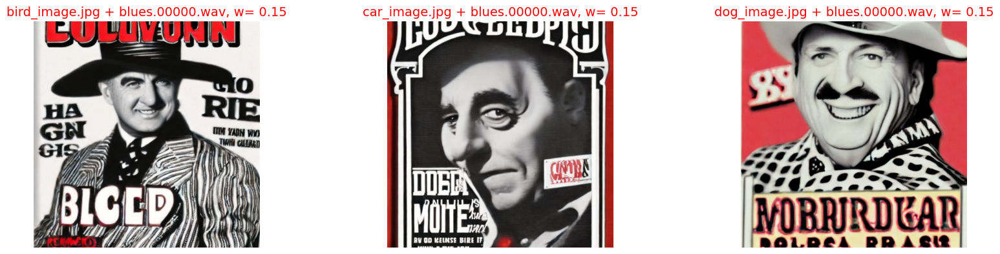

In [61]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    image_paths=[".assets/bird_image.jpg", ".assets/car_image.jpg",".assets/dog_image.jpg" ]

    embeddings = model.forward({
        ModalityType.VISION: data.load_and_transform_vision_data(image_paths, device),
    },  normalize = False)

    img_embeddings = embeddings[ModalityType.VISION]


    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data([out_f], device),
    })
    audio_embeddings = embeddings[ModalityType.AUDIO]

    w = 0.15
    embeddings = img_embeddings * w + audio_embeddings * (1-w)

    gen_images = []

    for emb in embeddings:
        img = pipe(
            image_embeds=emb[None].half(),
            generator = generator
            ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, image_path) in enumerate(zip(gen_images, image_paths)):

    name = image_path.split('/')[-1]

    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(f'{name} + {music_name}, w= {w}', fontdict={'fontsize': 14, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

### Умешьшим вес музыки

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

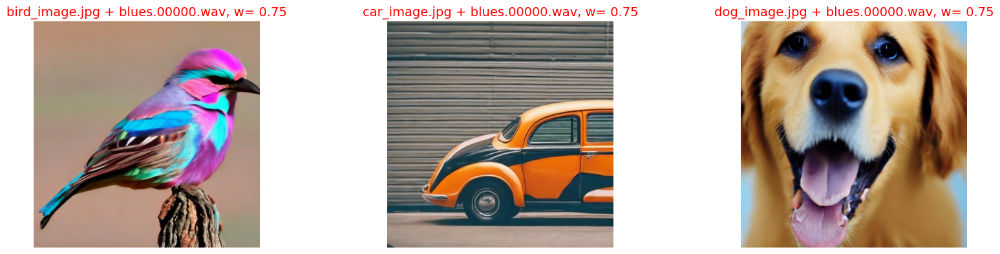

In [62]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    image_paths=[".assets/bird_image.jpg", ".assets/car_image.jpg",".assets/dog_image.jpg" ]

    embeddings = model.forward({
        ModalityType.VISION: data.load_and_transform_vision_data(image_paths, device),
    },  normalize = False)

    img_embeddings = embeddings[ModalityType.VISION]


    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data([out_f], device),
    })
    audio_embeddings = embeddings[ModalityType.AUDIO]

    w = 0.75
    embeddings = img_embeddings * w + audio_embeddings * (1-w)

    gen_images = []

    for emb in embeddings:
        img = pipe(
            image_embeds=emb[None].half(),
            generator = generator
            ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, image_path) in enumerate(zip(gen_images, image_paths)):

    name = image_path.split('/')[-1]

    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(f'{name} + {music_name}, w= {w}', fontdict={'fontsize': 14, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

СУПЕР! Мы получили новые картинки на тему исходных, но в новом исполнении и мы не трогаем шум!

### Убирем нормализацию и музыке

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

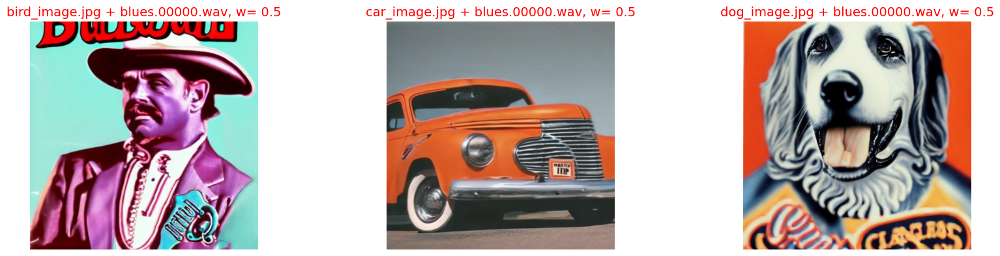

In [63]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    image_paths=[".assets/bird_image.jpg", ".assets/car_image.jpg",".assets/dog_image.jpg" ]

    embeddings = model.forward({
        ModalityType.VISION: data.load_and_transform_vision_data(image_paths, device),
    },  normalize = False)

    img_embeddings = embeddings[ModalityType.VISION]


    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data([out_f], device),
    },  normalize = False)
    audio_embeddings = embeddings[ModalityType.AUDIO]

    w = 0.5
    embeddings = img_embeddings * w + audio_embeddings * (1-w)

    gen_images = []

    for emb in embeddings:
        img = pipe(
            image_embeds=emb[None].half(),
            generator = generator
            ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, image_path) in enumerate(zip(gen_images, image_paths)):

    name = image_path.split('/')[-1]

    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(f'{name} + {music_name}, w= {w}', fontdict={'fontsize': 14, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

Интересно, что собака и машина остались, а вот птица не появилась. Видимо пение у человека и пение птицы много ближе в пространстве.

## Генерация музыки для исследования

воспользуемся этим ноутом и сгенерим музыку
https://colab.research.google.com/github/sanchit-gandhi/notebooks/blob/main/MusicGen.ipynb

### Unconditional Generation

The inputs for unconditional (or 'null') generation can be obtained through the method `MusicgenForConditionalGeneration.get_unconditional_inputs`. We can then run auto-regressive generation using the `.generate` method, specifying `do_sample=True` to enable sampling mode:

In [37]:
from transformers import MusicgenForConditionalGeneration

model_music = MusicgenForConditionalGeneration.from_pretrained("facebook/musicgen-small")

/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:30: UserWarning: torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.
  warnings.warn("torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.")


In [38]:
model_music.to(device)

unconditional_inputs = model_music.get_unconditional_inputs(num_samples=1)

audio_values = model_music.generate(**unconditional_inputs, do_sample=True, max_new_tokens=256)

In [40]:
sampling_rate = model_music.config.audio_encoder.sampling_rate
ipd.Audio(audio_values[0].cpu().numpy(), rate=sampling_rate)

In [64]:
import scipy.io.wavfile as wavf
music_name = 'musicgen_out.wav'
out_f = '/content/ImageBind/.assets/'+ music_name
res = audio_values[0, 0].cpu().numpy()
wavf.write(out_f, rate=sampling_rate, data=res)

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

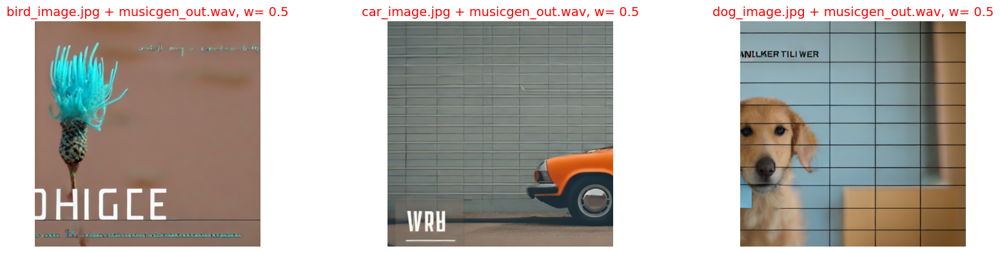

In [65]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    image_paths=[".assets/bird_image.jpg", ".assets/car_image.jpg",".assets/dog_image.jpg" ]

    embeddings = model.forward({
        ModalityType.VISION: data.load_and_transform_vision_data(image_paths, device),
    },  normalize = False)

    img_embeddings = embeddings[ModalityType.VISION]


    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data([out_f], device),
    },  normalize = False)
    audio_embeddings = embeddings[ModalityType.AUDIO]

    w = 0.5
    embeddings = img_embeddings * w + audio_embeddings * (1-w)

    gen_images = []

    for emb in embeddings:
        img = pipe(
            image_embeds=emb[None].half(),
            generator = generator
            ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, image_path) in enumerate(zip(gen_images, image_paths)):

    name = image_path.split('/')[-1]

    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(f'{name} + {music_name}, w= {w}', fontdict={'fontsize': 14, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

### Text-Conditional Generation

The model can generate an audio sample conditioned on a text prompt through use of the `MusicgenProcessor` to pre-process
the inputs. The pre-processed inputs can then be passed to the `.generate` method to generate text-conditional audio samples.
Again, we enable sampling mode by setting `do_sample=True`:

In [67]:
from transformers import AutoProcessor

processor = AutoProcessor.from_pretrained("facebook/musicgen-small")

inputs = processor(
    text=[ "90s rock song with loud guitars and heavy drums"],
    padding=True,
    return_tensors="pt",
)

audio_values = model_music.generate(**inputs.to(device), do_sample=True,
                              guidance_scale=3, max_new_tokens=256)

ipd.Audio(audio_values[0].cpu().numpy(), rate=sampling_rate)

In [68]:
import scipy.io.wavfile as wavf
music_name = 'musicgen_out_1.wav'
out_f = '/content/ImageBind/.assets/'+ music_name
res = audio_values[0, 0].cpu().numpy()
wavf.write(out_f, rate=sampling_rate, data=res)

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

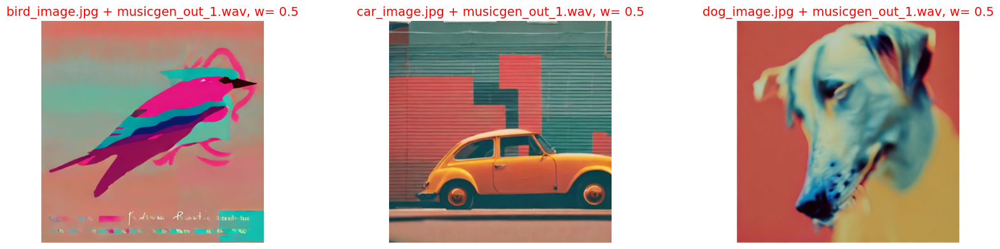

In [69]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    image_paths=[".assets/bird_image.jpg", ".assets/car_image.jpg",".assets/dog_image.jpg" ]

    embeddings = model.forward({
        ModalityType.VISION: data.load_and_transform_vision_data(image_paths, device),
    },  normalize = False)

    img_embeddings = embeddings[ModalityType.VISION]


    embeddings = model.forward({
        ModalityType.AUDIO: data.load_and_transform_audio_data([out_f], device),
    },  normalize = False)
    audio_embeddings = embeddings[ModalityType.AUDIO]

    w = 0.5
    embeddings = img_embeddings * w + audio_embeddings * (1-w)

    gen_images = []

    for emb in embeddings:
        img = pipe(
            image_embeds=emb[None].half(),
            generator = generator
            ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, image_path) in enumerate(zip(gen_images, image_paths)):

    name = image_path.split('/')[-1]

    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(f'{name} + {music_name}, w= {w}', fontdict={'fontsize': 14, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

В общем непочатое поле для исследоваий

## Image to Image

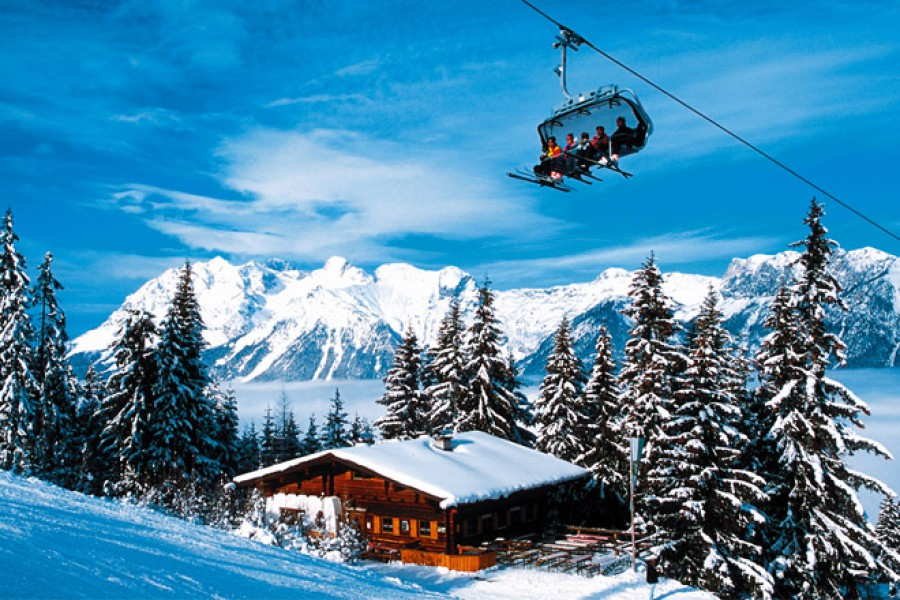

In [71]:
import requests
url = 'https://kgd.ru/media/k2/items/cache/045e263db67e029b97fc5298a8cfa5a3_XL.jpg'
im = Image.open(requests.get(url, stream=True).raw)
path_img = '/content/ImageBind/.assets/int_img.jpg'
im.save(path_img)
im

  0%|          | 0/21 [00:00<?, ?it/s]

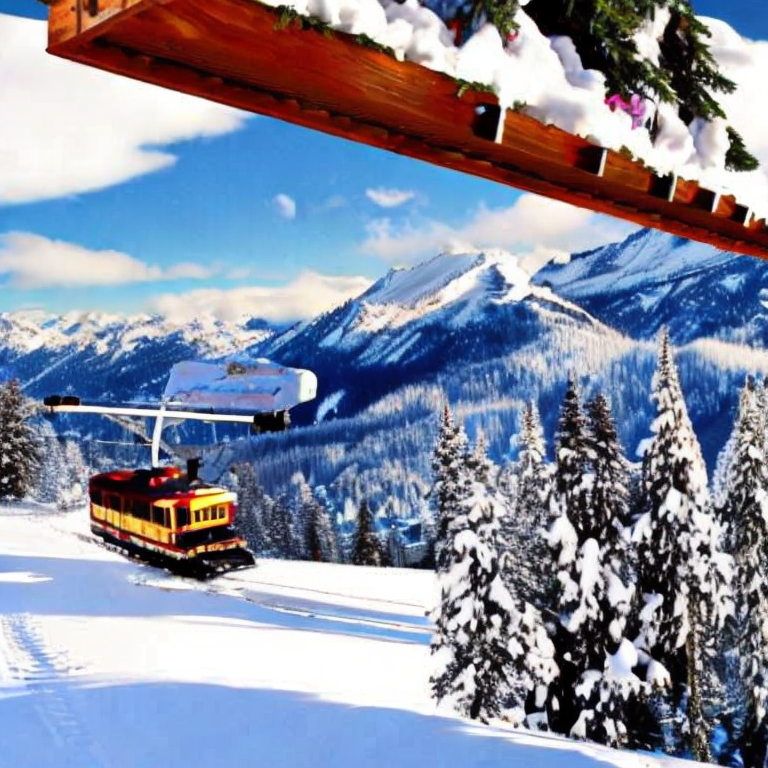

In [73]:
# generate seed image
generator = torch.manual_seed(10)

with torch.no_grad():

    embeddings = model.forward({
        ModalityType.VISION: data.load_and_transform_vision_data([path_img], device),
    },  normalize = False )
    img_embeddings = embeddings[ModalityType.VISION]
    images = pipe(image_embeds=img_embeddings.half(),
                  generator = generator
    ).images
images[0]

## Text to Image

  0%|          | 0/21 [00:00<?, ?it/s]

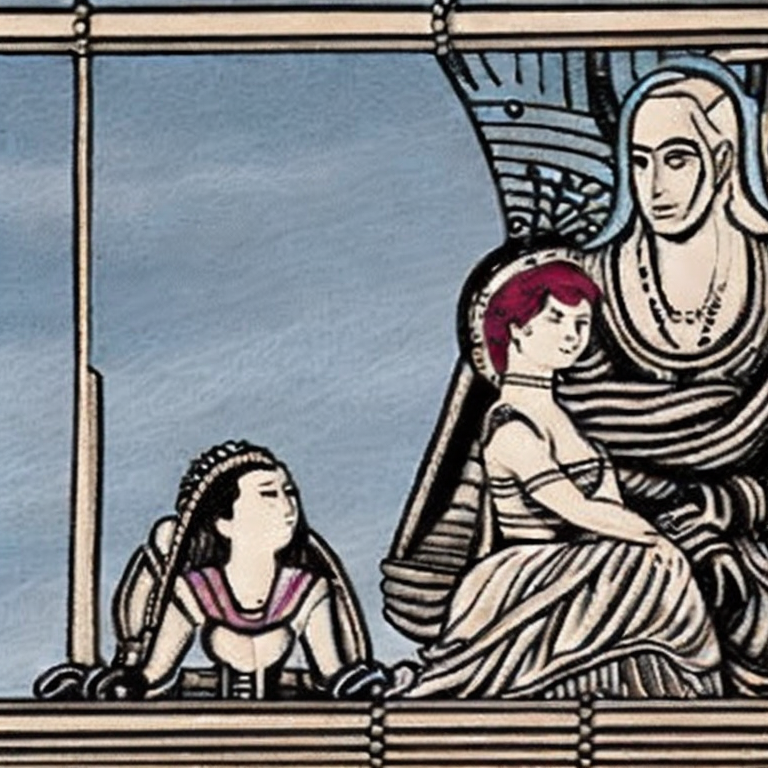

In [75]:
# generate seed image
generator = torch.manual_seed(100)

with torch.no_grad():
    embeddings = model.forward({
        ModalityType.TEXT: data.load_and_transform_text(['Cleopatra with Caesar on the ship.'], device),
    }, normalize=False)
    text_embeddings = embeddings[ModalityType.TEXT]

    images = pipe(image_embeds=text_embeddings.half(),
                  generator = generator

    ).imagesText
images[0]

### Text to Image with additionsl prompt

Что-то вполне осмысленное!!

Интересно, а что если добавить еще дополнительно  промпт

  0%|          | 0/21 [00:00<?, ?it/s]

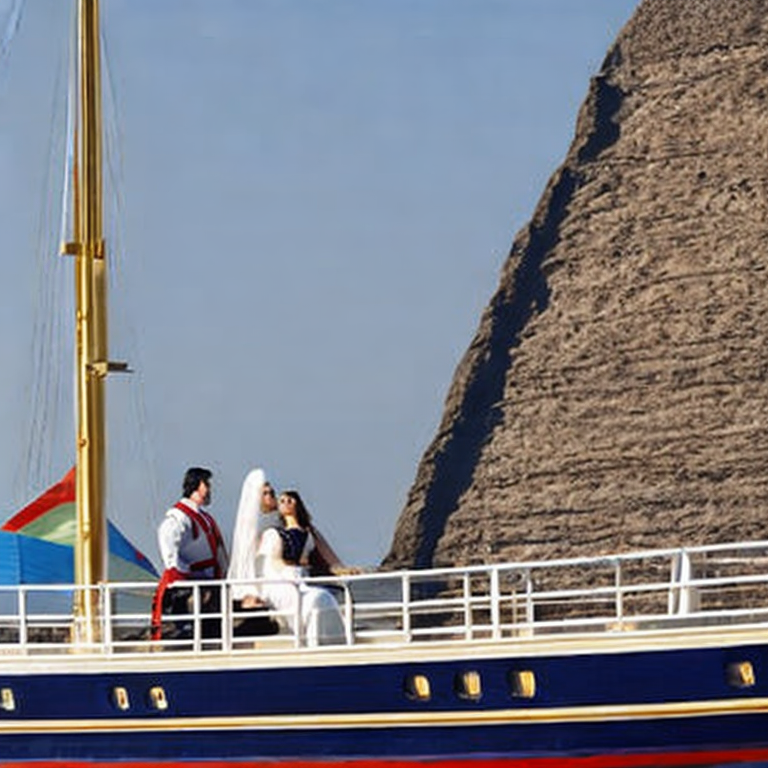

In [80]:
# generate seed image
generator = torch.manual_seed(100)

with torch.no_grad():
    embeddings = model.forward({
        ModalityType.TEXT: data.load_and_transform_text(['Cleopatra with Caesar on the ship.'], device),
    }, normalize=False)
    text_embeddings = embeddings[ModalityType.TEXT]

    images = pipe(image_embeds=text_embeddings.half(),
                  prompt = 'the ship sails against the backdrop of the Cheops pyramid',
                  generator = generator,
                  negative_prompt = 'longbody,bad lags, bad head, bad face, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality'

    ).images
images[0]

Интересно, что и пирамида тут и корабль и люди похожие из запроса в эмбединге

## Depth to Image

##### normalize = True

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

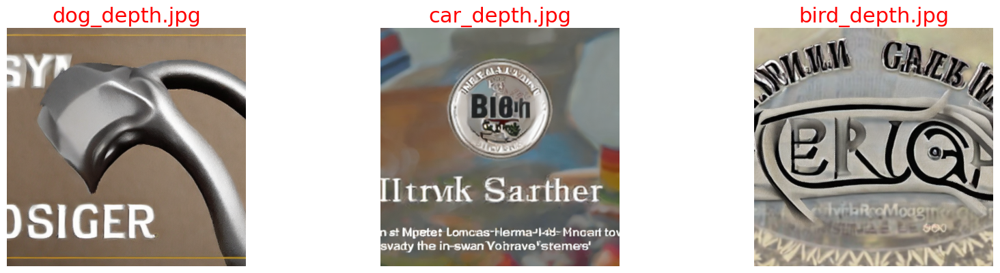

In [77]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    depth_paths = [".assets/dog_depth.jpg", ".assets/car_depth.jpg", ".assets/bird_depth.jpg"]


    embeddings = model.forward({
        ModalityType.DEPTH: load_and_transform_depth_data(depth_paths, device),
    })
    depth_embeddings = embeddings[ModalityType.DEPTH]

    gen_images = []
    for emb in depth_embeddings:
        img = pipe(image_embeds=emb[None].half(),
                   generator = generator
        ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, path) in enumerate(zip(gen_images, depth_paths)):
    name = path.split('/')[-1]
    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(name, fontdict={'fontsize': 22, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

##### normalize = False

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

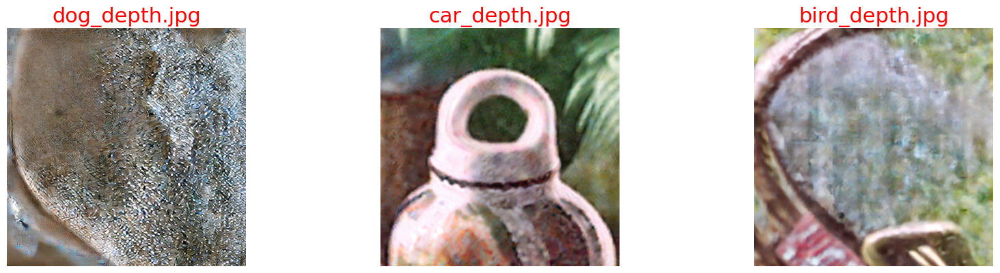

In [78]:
# generate seed image
generator = torch.manual_seed(10)

# generate image
with torch.no_grad():

    depth_paths = [".assets/dog_depth.jpg", ".assets/car_depth.jpg", ".assets/bird_depth.jpg"]


    embeddings = model.forward({
        ModalityType.DEPTH: load_and_transform_depth_data(depth_paths, device),
    }, normalize=False)
    depth_embeddings = embeddings[ModalityType.DEPTH]

    gen_images = []
    for emb in depth_embeddings:
        img = pipe(image_embeds=emb[None].half(),
                   generator = generator
        ).images
        gen_images.append(img[0])

plt.figure(figsize=(20,10))
columns = 3
for i, (image, path) in enumerate(zip(gen_images, depth_paths)):
    name = path.split('/')[-1]
    plt.subplot(int(len(gen_images) / columns + 1), columns, i + 1)
    plt.imshow(image)
    plt.title(name, fontdict={'fontsize': 22, 'fontweight': 'medium', 'color':'red'})
    plt.axis(False)

Не понятно, но интересно.....